<a href="https://colab.research.google.com/github/valsson-group/UNT-Chem3520/blob/main/Python/HF_MolecularOrbitals_CO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Molecular Orbitals from Hartree-Fock Calculations

Simple Juypter notebook that performs Hartree-Fock calculations using pyscf.

Part of the code take from and inspired by https://www.andersle.no/posts/2022/mo/mo.html

## Setup python environment and imports

In [ ]:
%%capture
!pip install numpy
!pip install scipy
!pip install Cython
!pip install pandas
!pip install sklearn
!pip install statsmodels
!pip install matplotlib
!pip install seaborn
!pip install rdkit
!pip install py3Dmol
!pip install ipywidgets
!pip install sphinx
!pip install nbsphinx
!pip install pydata-sphinx-theme
!pip install lxml
!pip install fortecubeview
!pip install pythreejs
!pip install scikit-image
!pip install pyscf
!pip install shap
!pip install catboost
!pip install graphviz

In [ ]:
import pathlib

# RDKit imports:
from rdkit import Chem
from rdkit.Chem import (
    AllChem,
    rdCoordGen,
)
from rdkit.Chem.Draw import IPythonConsole

IPythonConsole.ipython_useSVG = True  # Use higher quality images for molecules

# For visualization of molecules and orbitals:
import py3Dmol
import fortecubeview

# pyscf imports:
import pyscf

# For plotting
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set_theme(style="ticks", context="talk", palette="muted")

# For numerics:
import numpy as np
import pandas as pd

from google.colab import output
output.enable_custom_widget_manager()

pd.options.display.float_format = "{:,.3f}".format

## Definition of Molecule from SMILES String

**Here you should define the smiles string for the molecule you want to consider**




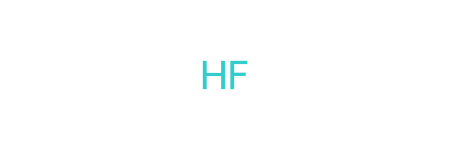

In [ ]:
molecule_smiles = "[C-]#[O+]" #@param {type:"string"}

molecule_name = "Mol"
molecule = Chem.MolFromSmiles(molecule_smiles)  # Generate the molecule from smiles
molecule

## Setup of Molecule

In [ ]:
def get_xyz(molecule, optimize=False):
    """Get xyz-coordinates for the molecule"""
    mol = Chem.Mol(molecule)
    mol = AllChem.AddHs(mol, addCoords=True)
    AllChem.EmbedMolecule(mol)
    if optimize:  # Optimize the molecules with the MM force field:
        AllChem.MMFFOptimizeMolecule(mol)
    xyz = []
    for lines in Chem.MolToXYZBlock(mol).split("\n")[2:]:
        strip = lines.strip()
        if strip:
            xyz.append(strip)
    xyz = "\n".join(xyz)
    return mol, xyz

In [ ]:
molecule3d, xyz = get_xyz(molecule, optimize=True)
print(xyz)

F      0.487766    0.000000    0.000000
H     -0.487766    0.000000    0.000000


In [ ]:
view = py3Dmol.view(
    data=Chem.MolToMolBlock(molecule3d),
    style={"stick": {}, "sphere": {"scale": 0.3}},
    width=300,
    height=300,
)
view.zoomTo()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## Hartree-Fock Calculations

In [ ]:
def run_calculation(xyz, basis="sto-3g"):
    """Calculate the energy (+ additional things like MO coefficients) with pyscf."""
    mol = pyscf.gto.M(
        atom=xyz,
        basis=basis,
        unit="ANG",
        symmetry=False,
    )
    mol.build()
    mf = pyscf.scf.RHF(mol).run()
    return mf, mol

In [ ]:
mf, mol = run_calculation(xyz, basis="cc-pvdz")

converged SCF energy = -100.013835232102


## Analysis of Results

In [ ]:
mf.analyze(verbose=4)

**** SCF Summaries ****
Total Energy =                        -100.013835232101542
Nuclear Repulsion Energy =               4.882048870031943
One-electron Energy =                 -150.163006814554876
Two-electron Energy =                   45.267122712421397
**** MO energy ****
MO #1   energy= -26.2790020101531  occ= 2
MO #2   energy= -1.56445083717395  occ= 2
MO #3   energy= -0.724242487376532 occ= 2
MO #4   energy= -0.623342844412115 occ= 2
MO #5   energy= -0.623342844412114 occ= 2
MO #6   energy= 0.170545687508693  occ= 0
MO #7   energy= 0.757032826459357  occ= 0
MO #8   energy= 1.3914727893021    occ= 0
MO #9   energy= 1.3914727893021    occ= 0
MO #10  energy= 1.43694695203399   occ= 0
MO #11  energy= 1.61234908623506   occ= 0
MO #12  energy= 1.61234908623507   occ= 0
MO #13  energy= 2.13701061754358   occ= 0
MO #14  energy= 2.35191949626428   occ= 0
MO #15  energy= 4.01000239143358   occ= 0
MO #16  energy= 4.01000239143358   occ= 0
MO #17  energy= 4.22724397367672   occ= 0
MO #18

((array([1.99999787e+00, 1.85824142e+00, 1.75006963e-03, 1.55396472e+00,
         1.99696386e+00, 1.99696386e+00, 5.38493259e-04, 5.11233690e-04,
         5.11233690e-04, 4.37238797e-04, 1.85709811e-31, 7.66363549e-04,
         4.37238797e-04, 2.29909065e-03, 5.64541304e-01, 1.52920983e-02,
         2.60856814e-03, 2.08766344e-03, 2.08766344e-03]),
  array([-0.4133827,  0.4133827])),
 array([-2.06641631e+00,  8.41217488e-16, -1.62851995e-15]))

In [ ]:
table = pd.DataFrame({"Energy": mf.mo_energy, "Occupancy": mf.mo_occ})
table

,Energy,Occupancy
0,-26.279,2.000
1,-1.564,2.000
2,-0.724,2.000
3,-0.623,2.000
4,-0.623,2.000
5,0.171,0.000
6,0.757,0.000
7,1.391,0.000
8,1.391,0.000
9,1.437,0.000


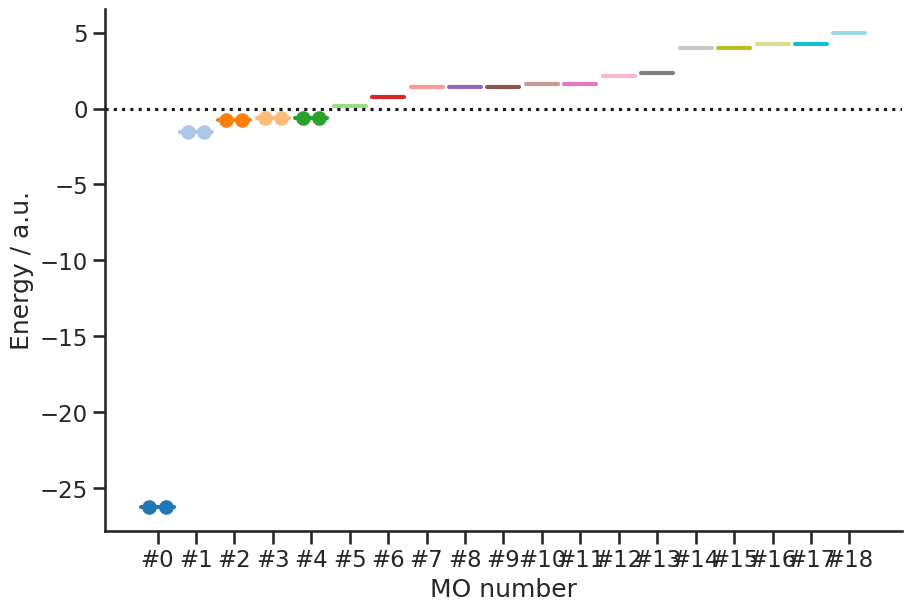

In [ ]:
fig, ax = plt.subplots(constrained_layout=True, figsize=(9, 6))
colors = matplotlib.colormaps.get_cmap("tab20")(np.linspace(0, 1, len(mf.mo_energy)))

pos = []
for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
    left = 3 * i
    right = 3 * i + 2.5
    length = right - left

    (line,) = ax.plot([left, right], [energy, energy], color=colors[i], lw=3)

    electron_x, electron_y = None, None
    if occ == 2:
        electron_x = [left + 0.25 * length, left + 0.75 * length]
        electron_y = [energy, energy]
    elif occ == 1:
        electron_x, electron_y = [left + 0.5], [energy]
    if electron_x and electron_y:
        ax.scatter(electron_x, electron_y, color=line.get_color())

    pos.append(left + 0.5 * length)

ax.axhline(y=0, ls=":", color="k")
ax.set_xticks(pos)
ax.set_xticklabels([f"#{i}" for i, _ in enumerate(pos)])
ax.set(xlabel="MO number", ylabel="Energy / a.u.")
sns.despine(fig=fig)

## Setup Orbitals

In [ ]:
def write_cube_files(
    max_homo_lumo=5, prefix="", dirname=".", margin=5, write_all_orbitals=False
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    # find index of HOMO and LUMO
    lumo = float("inf")
    lumo_idx = None
    homo = -float("inf")
    homo_idx = None
    for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
        if occ > 0 and energy > homo:
            homo = energy
            homo_idx = i
        if occ == 0 and energy < lumo:
            lumo = energy
            lumo_idx = i

    print(f"HOMO (index): {homo_idx}")
    print(f"LUMO (index): {lumo_idx}")
    print("")


    if(write_all_orbitals):
      for i in range(mf.mo_coeff.shape[1]):
        outfile = f"{prefix}Orbital-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, i], margin=margin)
    else:
      print("")
      outfile = f"{prefix}HOMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx], margin=margin)

      outfile = f"{prefix}LUMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx], margin=margin)

      for i in range(1,max_homo_lumo+1):
        outfile = f"{prefix}HOMO_minus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx-i], margin=margin)

        outfile = f"{prefix}LUMO_plus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx+i], margin=margin)

In [ ]:
!rm -rf cube_files
write_cube_files(
   dirname="cube_files",
   write_all_orbitals=True
)

HOMO (index): 4
LUMO (index): 5

Writing cube_files/Orbital-00.cube
Writing cube_files/Orbital-01.cube
Writing cube_files/Orbital-02.cube
Writing cube_files/Orbital-03.cube
Writing cube_files/Orbital-04.cube
Writing cube_files/Orbital-05.cube
Writing cube_files/Orbital-06.cube
Writing cube_files/Orbital-07.cube
Writing cube_files/Orbital-08.cube
Writing cube_files/Orbital-09.cube
Writing cube_files/Orbital-10.cube
Writing cube_files/Orbital-11.cube
Writing cube_files/Orbital-12.cube
Writing cube_files/Orbital-13.cube
Writing cube_files/Orbital-14.cube
Writing cube_files/Orbital-15.cube
Writing cube_files/Orbital-16.cube
Writing cube_files/Orbital-17.cube
Writing cube_files/Orbital-18.cube


## Visualize Orbitals

In [ ]:
fortecubeview.plot(path="./cube_files/", width=600, height=300, colorscheme='national')

CubeViewer: listing cube files from the directory ./cube_files/
Reading 19 cube files


HTML(value='\n        <style>\n           .jupyter-widgets-output-area .output_scroll {\n                heigh…

interactive(children=(Select(description='Cube files:', options=('./cube_files/Orbital-00.cube', './cube_files…

TraitError: The 'target' trait of a DirectionalLight instance expected an Uninitialized or an Object3D, not the str 'IPY_MODEL_ae25d13e-a24c-4de6-a0c9-7c0d44a0b8af'.